5214513_Linjun Wang; 5209587_Yuzhen Jin

# 1 Classification of 60m image

In [2]:
import rasterio
from rasterio.windows import Window
from matplotlib import pyplot as plt
from matplotlib import colors
from sklearn import cluster
import numpy as np
from sklearn import metrics
from sklearn.cluster import KMeans
B01_60m = rasterio.open('.\GRANULE\L2A_T31UET_A025788_20200530T105134\IMG_DATA\R60m\T31UET_20200530T105031_B01_60m.jp2')
B02_60m = rasterio.open('.\GRANULE\L2A_T31UET_A025788_20200530T105134\IMG_DATA\R60m\T31UET_20200530T105031_B02_60m.jp2')
B03_60m = rasterio.open('.\GRANULE\L2A_T31UET_A025788_20200530T105134\IMG_DATA\R60m\T31UET_20200530T105031_B03_60m.jp2')
B04_60m = rasterio.open('.\GRANULE\L2A_T31UET_A025788_20200530T105134\IMG_DATA\R60m\T31UET_20200530T105031_B04_60m.jp2')
B05_60m = rasterio.open('.\GRANULE\L2A_T31UET_A025788_20200530T105134\IMG_DATA\R60m\T31UET_20200530T105031_B05_60m.jp2')
B06_60m = rasterio.open('.\GRANULE\L2A_T31UET_A025788_20200530T105134\IMG_DATA\R60m\T31UET_20200530T105031_B06_60m.jp2')
B07_60m = rasterio.open('.\GRANULE\L2A_T31UET_A025788_20200530T105134\IMG_DATA\R60m\T31UET_20200530T105031_B07_60m.jp2')
B8A_60m = rasterio.open('.\GRANULE\L2A_T31UET_A025788_20200530T105134\IMG_DATA\R60m\T31UET_20200530T105031_B8A_60m.jp2')
B09_60m = rasterio.open('.\GRANULE\L2A_T31UET_A025788_20200530T105134\IMG_DATA\R60m\T31UET_20200530T105031_B09_60m.jp2')
B11_60m = rasterio.open('.\GRANULE\L2A_T31UET_A025788_20200530T105134\IMG_DATA\R60m\T31UET_20200530T105031_B11_60m.jp2')
B12_60m = rasterio.open('.\GRANULE\L2A_T31UET_A025788_20200530T105134\IMG_DATA\R60m\T31UET_20200530T105031_B12_60m.jp2')

In [3]:
def kmeans(blist,n):
    imgxyb = np.empty((blist[0].height, blist[0].width, len(blist)), blist[0].meta['dtype'])
    for i in range(len(blist)):
        imgxyb[:,:,i] = blist[i].read()
    img1d = imgxyb.reshape((imgxyb.shape[0]*imgxyb.shape[1],imgxyb.shape[2]))
    cl = cluster.KMeans(n_clusters=n) 
    param = cl.fit(img1d) 
    img_cl = cl.labels_ 
    img_cl = img_cl.reshape(imgxyb[:,:,0].shape)
    return img_cl

This function is the key part for k-means classification. There are two parameters in this function: blist and n, blist is a list of different bands and n is the number of clusters. Firstly, an empty 3-dimension array named imgxyb will be created. Every bands in blist will be stored in imgxyb. Secondly, this function will convert the first two dimensions(width and height) of imgxyb to 1 dimension and create a new array img1d. The array img1d is a 2-dimension array which can be used directly by the K-means classifier. Thirdly, we create an object of the classifier and train it. At last, we get labels of the classes and reshape the label to a 3-dimension array. This function will return the 3-dimension array img_cl.

## 1.1 Determining the number of class of 60m image
According to our observations of this 60m resolution image, there are at least four types of land use in this area, including water areas, urban land, farmland and the area of greenhouse. In order to determine the number of classes, we use all the 11 bands in 60m to classify with 4, 5, 6 and 7 clusters.

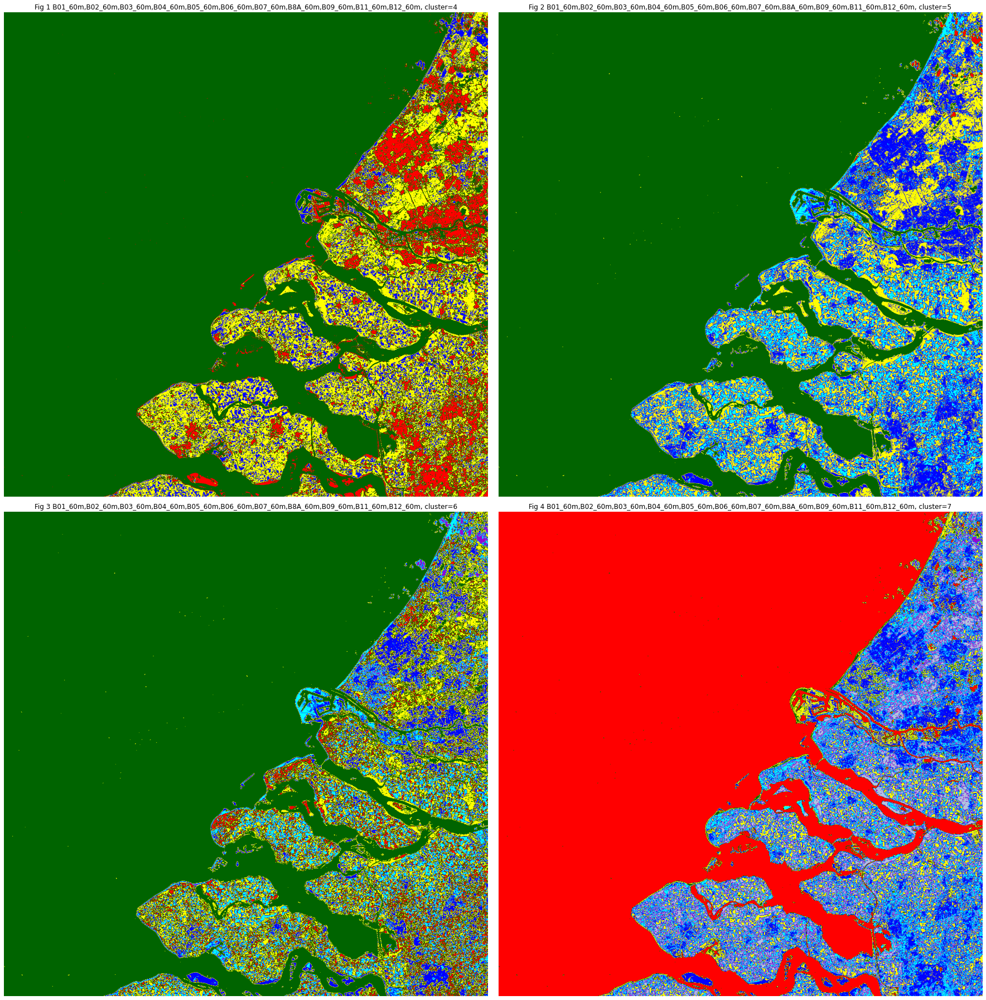

In [4]:
bands = [B01_60m,B02_60m,B03_60m,B04_60m,B05_60m,B06_60m,B07_60m,B8A_60m,B09_60m,B11_60m,B12_60m]
img_cl1 = kmeans(bands,4)
img_cl2 = kmeans(bands,5)
img_cl3 = kmeans(bands,6)
img_cl4 = kmeans(bands,7)
cmap1 = colors.LinearSegmentedColormap.from_list("", ["red","darkgreen","yellow","blue"])
cmap2 = colors.LinearSegmentedColormap.from_list("", ["red","darkgreen","yellow","blue","cyan"])
cmap3 = colors.LinearSegmentedColormap.from_list("", ["red","darkgreen","yellow","blue","cyan","darkviolet"])
cmap4 = colors.LinearSegmentedColormap.from_list("", ["red","darkgreen","yellow","blue","cyan","darkviolet","lightsteelblue"])
fig = plt.figure(figsize=[25,25])
ax1 = fig.add_subplot(221)
ax2 = fig.add_subplot(222)
ax3 = fig.add_subplot(223)
ax4 = fig.add_subplot(224)
ax1.imshow(img_cl1,cmap=cmap1)
ax1.set_title('Fig 1 B01_60m,B02_60m,B03_60m,B04_60m,B05_60m,B06_60m,B07_60m,B8A_60m,B09_60m,B11_60m,B12_60m, cluster=4')
ax2.imshow(img_cl2,cmap=cmap2)
ax2.set_title('Fig 2 B01_60m,B02_60m,B03_60m,B04_60m,B05_60m,B06_60m,B07_60m,B8A_60m,B09_60m,B11_60m,B12_60m, cluster=5')
ax3.imshow(img_cl3,cmap=cmap3)
ax3.set_title('Fig 3 B01_60m,B02_60m,B03_60m,B04_60m,B05_60m,B06_60m,B07_60m,B8A_60m,B09_60m,B11_60m,B12_60m, cluster=6')
ax4.imshow(img_cl4,cmap=cmap4)
ax4.set_title('Fig 4 B01_60m,B02_60m,B03_60m,B04_60m,B05_60m,B06_60m,B07_60m,B8A_60m,B09_60m,B11_60m,B12_60m, cluster=7')
ax1.axis('off')
ax2.axis('off')
ax3.axis('off')
ax4.axis('off')
plt.tight_layout()
plt.show()

The classification result of 4 classes(Fig 1) is clear but mix the greenhouse area and a part of farmland together. The result of 6 classes(Fig 3) can only show a little part of greenhouse and interior of each category is extremely fragmented so it also cannot match the actual situation. When we choose 7 classes(Fig 4), the result become so fragmentary and it's hard to identify different land use types. 

From the results above, we can conclude that 5 classes should be the best choice for 60m image. The result of 5 classes(Fig 2) can distinguish the area of greenhouse and different types of farmland which is much closer to the real situation. Other results are either too rough or too fragmentary for the classification. 

## 1.2 Classification of single bands
After determining the number of classes we are going to use. We used 6 single bands(Blue, Green, Red, NIR) with 5 clusters to observe the results of classification. 

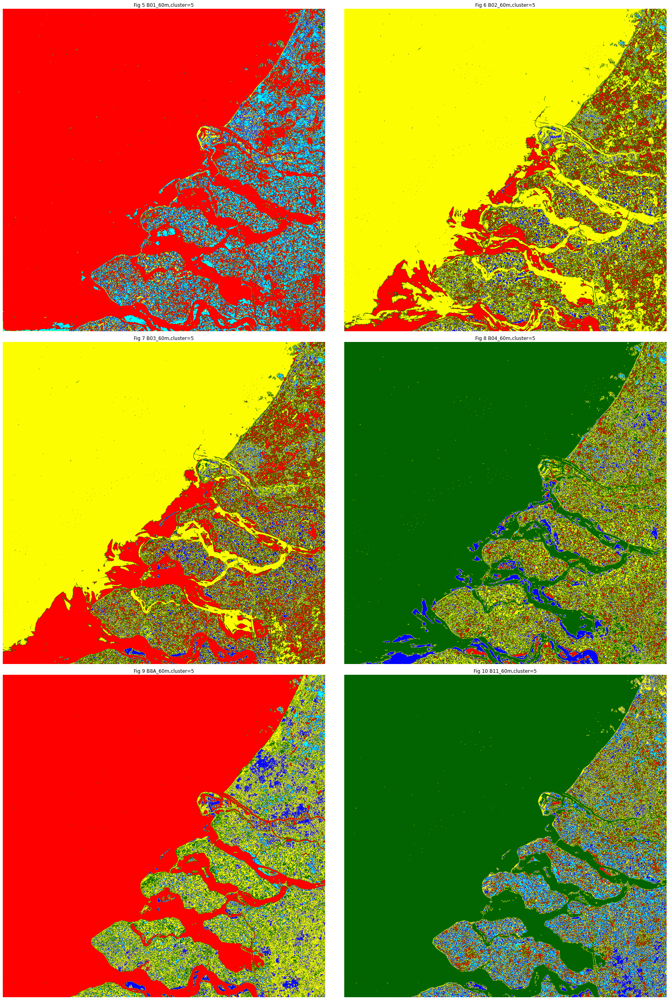

In [27]:
bands1 = [B01_60m]
bands2 = [B02_60m]
bands3 = [B03_60m]
bands4 = [B04_60m]
bands5 = [B8A_60m]
bands6 = [B11_60m]
img_cl1 = kmeans(bands1,5)
img_cl2 = kmeans(bands2,5)
img_cl3 = kmeans(bands3,5)
img_cl4 = kmeans(bands4,5)
img_cl5 = kmeans(bands5,5)
img_cl6 = kmeans(bands6,5)
cmap = colors.LinearSegmentedColormap.from_list("", ["red","darkgreen","yellow","blue","cyan"])
fig = plt.figure(figsize=[25,35])
ax1 = fig.add_subplot(321)
ax2 = fig.add_subplot(322)
ax3 = fig.add_subplot(323)
ax4 = fig.add_subplot(324)
ax5 = fig.add_subplot(325)
ax6 = fig.add_subplot(326)
ax1.imshow(img_cl1,cmap=cmap)
ax1.set_title('Fig 5 B01_60m, cluster=5')
ax2.imshow(img_cl2,cmap=cmap)
ax2.set_title('Fig 6 B02_60m, cluster=5')
ax3.imshow(img_cl3,cmap=cmap)
ax3.set_title('Fig 7 B03_60m, cluster=5')
ax4.imshow(img_cl4,cmap=cmap)
ax4.set_title('Fig 8 B04_60m, cluster=5')
ax5.imshow(img_cl5,cmap=cmap)
ax5.set_title('Fig 9 B8A_60m, cluster=5')
ax6.imshow(img_cl6,cmap=cmap)
ax6.set_title('Fig 10 B11_60m, cluster=5')
ax1.axis('off')
ax2.axis('off')
ax3.axis('off')
ax4.axis('off')
ax5.axis('off')
ax6.axis('off')
plt.tight_layout()
plt.show()                                                                                  

Fig 5 shows the result of band1(coastal aerosol) which is an awful classification result since too much of the land is divided into water.

According to Fig 6, Fig 7 and Fig 8, it's clear that band 2, 3 and 4 cannot be used individually because they cannot distinguish water areas properly. The sea area is divided into two parts in these results and water area on land also cannot be clearly classified. 

For the result of band 8A(Fig 9)，it's good enough for a single band classification, but there are still some problems such as the misclassification of different types of vegetation.

Fig 10 is the result of SWIR band, the water area is correctly divided but the categories on the land are too messy.

In conclusion, a single band cannot complete the task of classification because they cannot fully display the features of the ground objects separately.

## 1.3 Classification of different band combinations
In this part, we used different band combinations to explore the effect of different bands in classification.

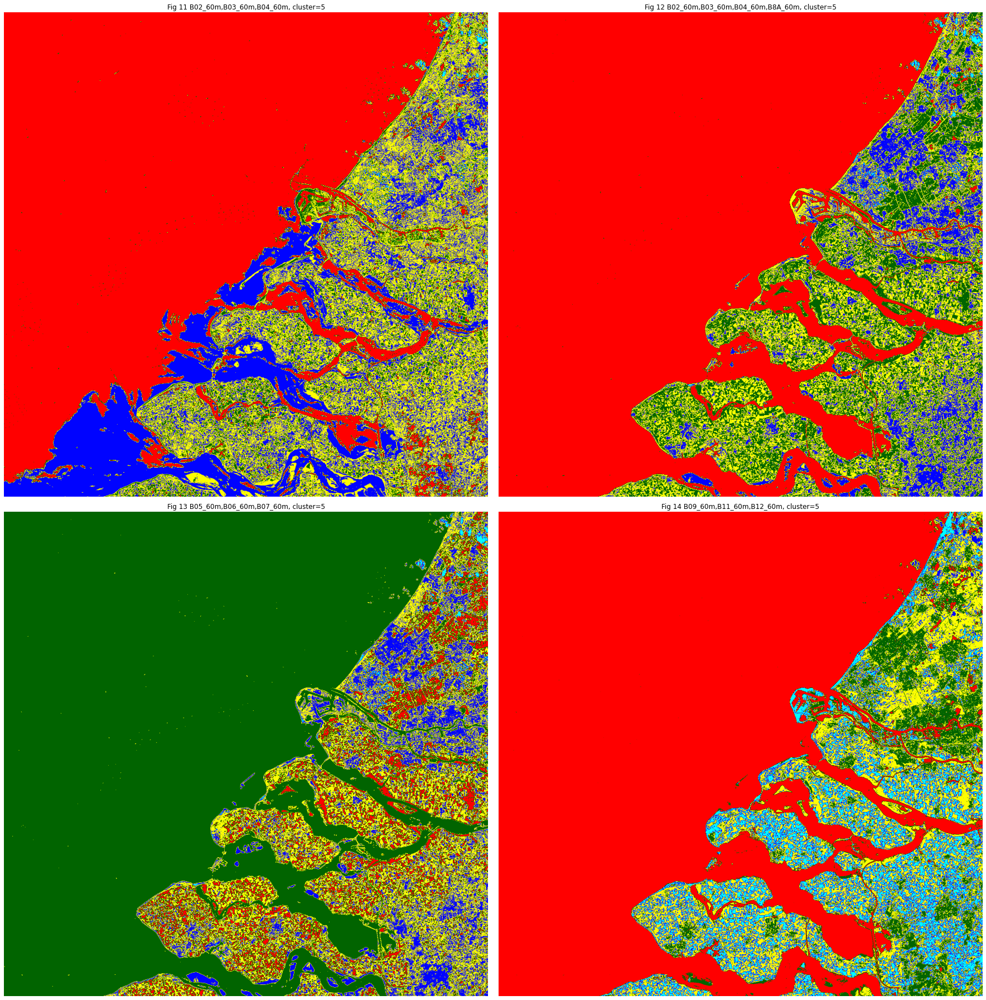

In [6]:
bands1 = [B02_60m,B03_60m,B04_60m]
bands2 = [B02_60m,B03_60m,B04_60m,B8A_60m]
bands3 = [B05_60m,B06_60m,B07_60m]
bands4 = [B09_60m,B11_60m,B12_60m]
img_cl1 = kmeans(bands1,5)
img_cl2 = kmeans(bands2,5)
img_cl3 = kmeans(bands3,5)
img_cl4 = kmeans(bands4,5)
cmap = colors.LinearSegmentedColormap.from_list("", ["red","darkgreen","yellow","blue","cyan"])
fig = plt.figure(figsize=[25,25])
ax1 = fig.add_subplot(221)
ax2 = fig.add_subplot(222)
ax3 = fig.add_subplot(223)
ax4 = fig.add_subplot(224)
ax1.imshow(img_cl1,cmap=cmap)
ax1.set_title('Fig 11 B02_60m,B03_60m,B04_60m, cluster=5')
ax2.imshow(img_cl2,cmap=cmap)
ax2.set_title('Fig 12 B02_60m,B03_60m,B04_60m,B8A_60m, cluster=5')
ax3.imshow(img_cl3,cmap=cmap)
ax3.set_title('Fig 13 B05_60m,B06_60m,B07_60m, cluster=5')
ax4.imshow(img_cl4,cmap=cmap)
ax4.set_title('Fig 14 B09_60m,B11_60m,B12_60m, cluster=5')
ax1.axis('off')
ax2.axis('off')
ax3.axis('off')
ax4.axis('off')
plt.tight_layout()
plt.show()

Fig 11 is the result of three visible light bands(band2, band3, band4). This result is relatively bad which almost mistakenly distinguished all the land use types.

When we added NIR band into the classification, the result(Fig 12) become much better. Urban area and farmland are clearly distinguished, different types of farmland are scattered and well-defined with clear boundaries. However, the greenhouse area cannot be correctly classified which should be a problem for the result of this band combination.  

Fig 13 is the result of three Vegetation Red Edge bands(band5,band6,band7). According to the vegetation spectra, we know that the red edge band should be very useful when we need to distinguish between vegetation and non-vegetation. This classification shows a satisfying result for farmlands but too many areas are divided into urban areas.

Fig 14 shows the result of three ShortWave InfraRed bands and it's a relatively good result which is somewhat similar with Fig 10. The flaw of this result is that the boundary of its farmland area is not divided well especially for the farmland in the North of this area.

According to these four results, we conclude that the band combination of band2, band3, band4 and band8A should participate in the classification process to get a better classification result.

Based on the conclusions obtained in the previous part, we try to combine the bands combination again to get better results. In this part, We fix the four bands of band2, band3, band4 and band8A, and add other bands to test the classification results.

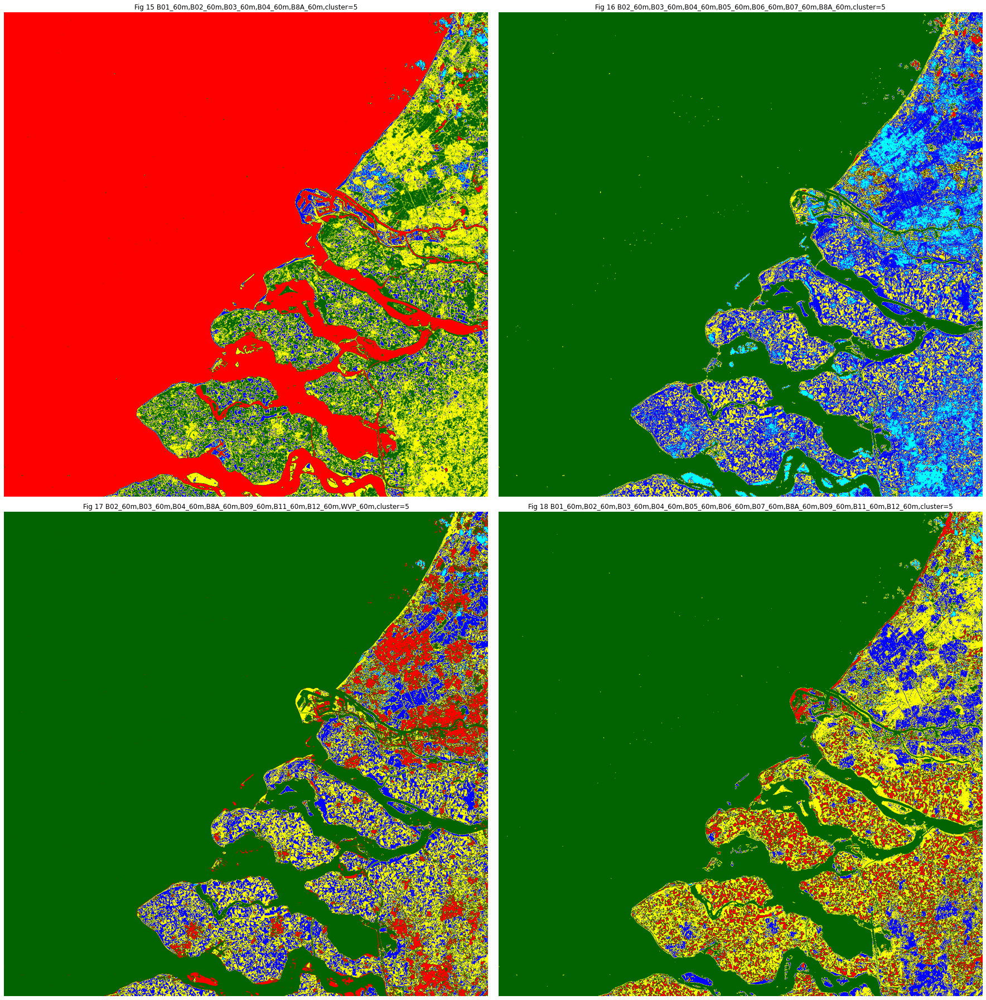

In [7]:
bands1 = [B01_60m,B02_60m,B03_60m,B04_60m,B8A_60m]
bands2 = [B02_60m,B03_60m,B04_60m,B05_60m,B06_60m,B07_60m,B8A_60m]
bands3 = [B02_60m,B03_60m,B04_60m,B8A_60m,B09_60m,B11_60m,B12_60m]
bands4 = [B01_60m,B02_60m,B03_60m,B04_60m,B05_60m,B06_60m,B07_60m,B8A_60m,B09_60m,B11_60m,B12_60m]
img_cl1 = kmeans(bands1,5)
img_cl2 = kmeans(bands2,5)
img_cl3 = kmeans(bands3,5)
img_cl4 = kmeans(bands4,5)
cmap = colors.LinearSegmentedColormap.from_list("", ["red","darkgreen","yellow","blue","cyan"])
fig = plt.figure(figsize=[25,25])
ax1 = fig.add_subplot(221)
ax2 = fig.add_subplot(222)
ax3 = fig.add_subplot(223)
ax4 = fig.add_subplot(224)
ax1.imshow(img_cl1,cmap=cmap)
ax1.set_title('Fig 15 B01_60m,B02_60m,B03_60m,B04_60m,B8A_60m,cluster=5')
ax2.imshow(img_cl2,cmap=cmap)
ax2.set_title('Fig 16 B02_60m,B03_60m,B04_60m,B05_60m,B06_60m,B07_60m,B8A_60m,cluster=5')
ax3.imshow(img_cl3,cmap=cmap)
ax3.set_title('Fig 17 B02_60m,B03_60m,B04_60m,B8A_60m,B09_60m,B11_60m,B12_60m,WVP_60m,cluster=5')
ax4.imshow(img_cl4,cmap=cmap)
ax4.set_title('Fig 18 B01_60m,B02_60m,B03_60m,B04_60m,B05_60m,B06_60m,B07_60m,B8A_60m,B09_60m,B11_60m,B12_60m,cluster=5')
ax1.axis('off')
ax2.axis('off')
ax3.axis('off')
ax4.axis('off')
plt.tight_layout()
plt.show()   

As we can see from the results above, all the result can basically distinguish the type of land use in the research area.

Fig 15 shows the result of the the first band combination(band1, band2, band3, band4, band8), it's the worst one in these four results because it divided too many areas into urban areas.

Fig 16, Fig 17 and Fig 18 are similar results and they all have good quality for classification, but there are still subtle difference between them. Fig 16 used Red Edge bands with band2, band3, band4 and band8, it shows more complete vegetation areas and the greenhouse area is also clearer than the other results. Fig 17(band2, band3, band4, band8A, band9, band11, band12) and Fig 18(all the 11 bands) are almost the same results, both of them cannot show greenhouse area properly.

# 2 Classification of 10m image

In [4]:
AOT_10m = rasterio.open('./GRANULE/L2A_T31UET_A025788_20200530T105134/IMG_DATA/R10m/T31UET_20200530T105031_AOT_10m.jp2')
B02_10m = rasterio.open('./GRANULE/L2A_T31UET_A025788_20200530T105134/IMG_DATA/R10m/T31UET_20200530T105031_B02_10m.jp2')
B03_10m = rasterio.open('./GRANULE/L2A_T31UET_A025788_20200530T105134/IMG_DATA/R10m/T31UET_20200530T105031_B03_10m.jp2')
B04_10m = rasterio.open('./GRANULE/L2A_T31UET_A025788_20200530T105134/IMG_DATA/R10m/T31UET_20200530T105031_B04_10m.jp2')
B08_10m = rasterio.open('./GRANULE/L2A_T31UET_A025788_20200530T105134/IMG_DATA/R10m/T31UET_20200530T105031_B08_10m.jp2')
TCI_10m = rasterio.open('./GRANULE/L2A_T31UET_A025788_20200530T105134/IMG_DATA/R10m/T31UET_20200530T105031_TCI_10m.jp2')
WVP_10m = rasterio.open('./GRANULE/L2A_T31UET_A025788_20200530T105134/IMG_DATA/R10m/T31UET_20200530T105031_WVP_10m.jp2')
py,px = B02_10m.index(601200,5773695)
win = Window(px,py,700,500)

In [7]:
def kmeans_window(blist,n,w):
    imgxyb = np.empty((500, 700, len(blist)), blist[0].meta['dtype'])
    for i in range(len(blist)):
        imgxyb[:,:,i] = blist[i].read(window = w)
    img1d = imgxyb.reshape((imgxyb.shape[0]*imgxyb.shape[1],imgxyb.shape[2]))
    cl = cluster.KMeans(n_clusters=n)
    param = cl.fit(img1d) 
    img_cl = cl.labels_ 
    img_cl = img_cl.reshape(imgxyb[:,:,0].shape)
    return img_cl

The function adds another parameter w to set the clustering on a subset of the whole picture.

## 2.1 Single band clustering
First of all, we set the number of clusters to five assuming that kmeans can properly classify water, buildings, farm land, trees and road(based on the landform of this area). We analyzed the Red, Green, Blue, NIR bands separately. In this way, we can distinguish which landforms each light band is beneficial to. Then we can combine different bands to get the classification result we want.

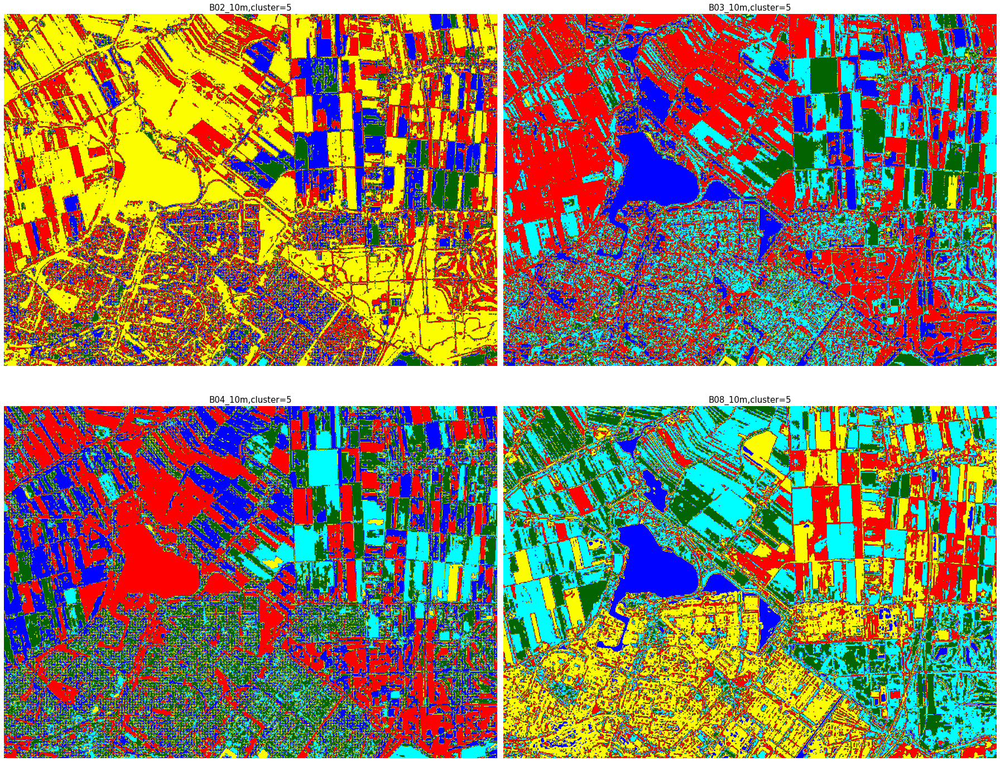

In [8]:
color = colors.LinearSegmentedColormap.from_list("", ["red","darkgreen","yellow","blue","cyan"]) 
fig = plt.figure(figsize=(25,20))
ax1 = fig.add_subplot(221)
bands_1 = [B02_10m]
ax1.imshow(kmeans_window(bands_1,5,win),cmap=color)
ax1.set_title('B02_10m,cluster=5',fontsize=15)
plt.axis('off')
ax2 = fig.add_subplot(222)
bands_2 = [B03_10m]
ax2.imshow(kmeans_window(bands_2,5,win),cmap=color)
ax2.set_title('B03_10m,cluster=5',fontsize=15)
plt.axis('off')
ax3 = fig.add_subplot(223)
bands_3 = [B04_10m]
ax3.imshow(kmeans_window(bands_3,5,win),cmap=color)
ax3.set_title('B04_10m,cluster=5',fontsize=15)
plt.axis('off')
ax4 = fig.add_subplot(224)
bands_4 = [B08_10m]
ax4.imshow(kmeans_window(bands_4,5,win),cmap=color)
ax4.set_title('B08_10m,cluster=5',fontsize=15)
plt.axis('off')
plt.tight_layout()
plt.show()

From the outcomes can tell only NIR band shows the most correct classification. It can be seen from the image that NIR has a good ability to distinguish water, farm land and vegetation. However, the separate four bands are not good enough to classify buildings.

## 2.2 True color bands and False color bands clustering
Next, we tried to combine and analyze the four bands in true color and false color to see if it can improve the classification of buildings.

<function matplotlib.pyplot.show(close=None, block=None)>

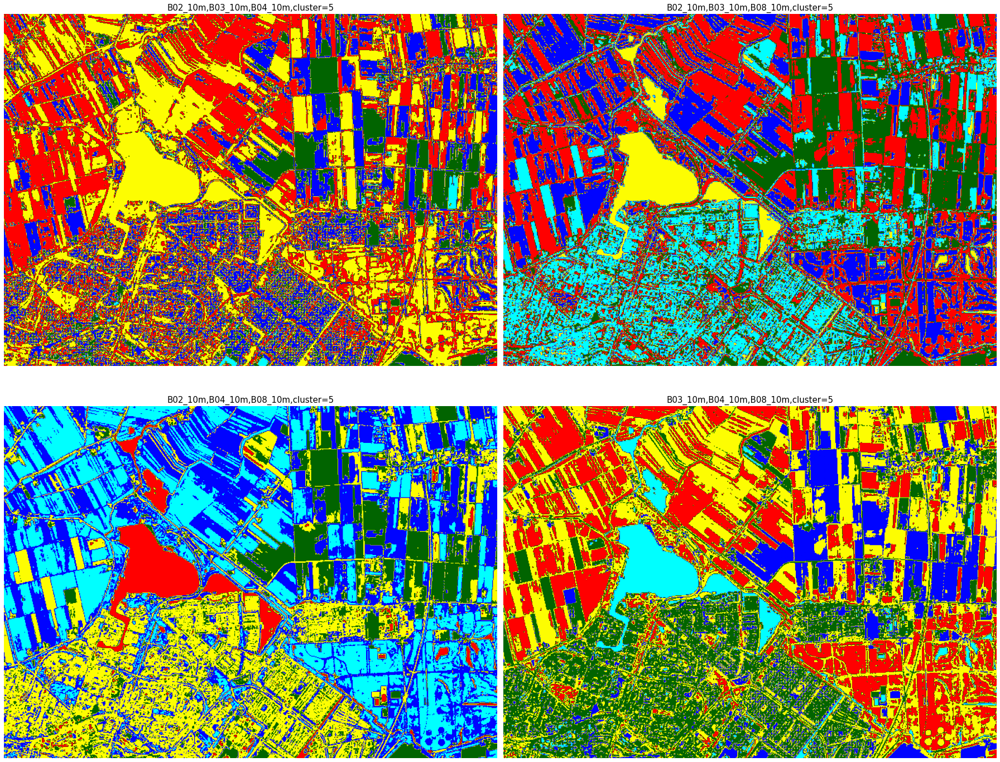

In [9]:
color = colors.LinearSegmentedColormap.from_list("", ["red","darkgreen","yellow","blue","cyan"]) 
fig = plt.figure(figsize=(25,20))
ax1 = fig.add_subplot(221)
bands_1 = [B02_10m,B03_10m,B04_10m]
ax1.imshow(kmeans_window(bands_1,5,win),cmap=color)
ax1.set_title('B02_10m,B03_10m,B04_10m,cluster=5',fontsize=15)
plt.axis('off')
ax2 = fig.add_subplot(222)
bands_2 = [B02_10m,B03_10m,B08_10m]
ax2.imshow(kmeans_window(bands_2,5,win),cmap=color)
ax2.set_title('B02_10m,B03_10m,B08_10m,cluster=5',fontsize=15)
plt.axis('off')
ax3 = fig.add_subplot(223)
bands_3 = [B02_10m,B04_10m,B08_10m]
ax3.imshow(kmeans_window(bands_3,5,win),cmap=color)
ax3.set_title('B02_10m,B04_10m,B08_10m,cluster=5',fontsize=15)
plt.axis('off')
ax4 = fig.add_subplot(224)
bands_4 = [B03_10m,B04_10m,B08_10m]
ax4.imshow(kmeans_window(bands_4,5,win),cmap=color)
ax4.set_title('B03_10m,B04_10m,B08_10m,cluster=5',fontsize=15)
plt.axis('off')
plt.tight_layout()
plt.show

It can be seen from the results that, like the single-band analysis, the true color lacks NIR band and cannot distinguish the water and farm land. Interestingly, the combination of Red band, Blue band and Green band with NIR band presents the same classification effect. Compared with the individual NIR band analysis, the distinction of buildings has been improved.

## 2.3 RGB NIR bands with AOT and WVP clustering
With previous conslusion, the combination of Red band, Green band, Blue band and NIR band can make good classifition of water, vegetation and buildings. Then we tested these four bands with either AOT or WVP or both to see if they can make more accurate classification.

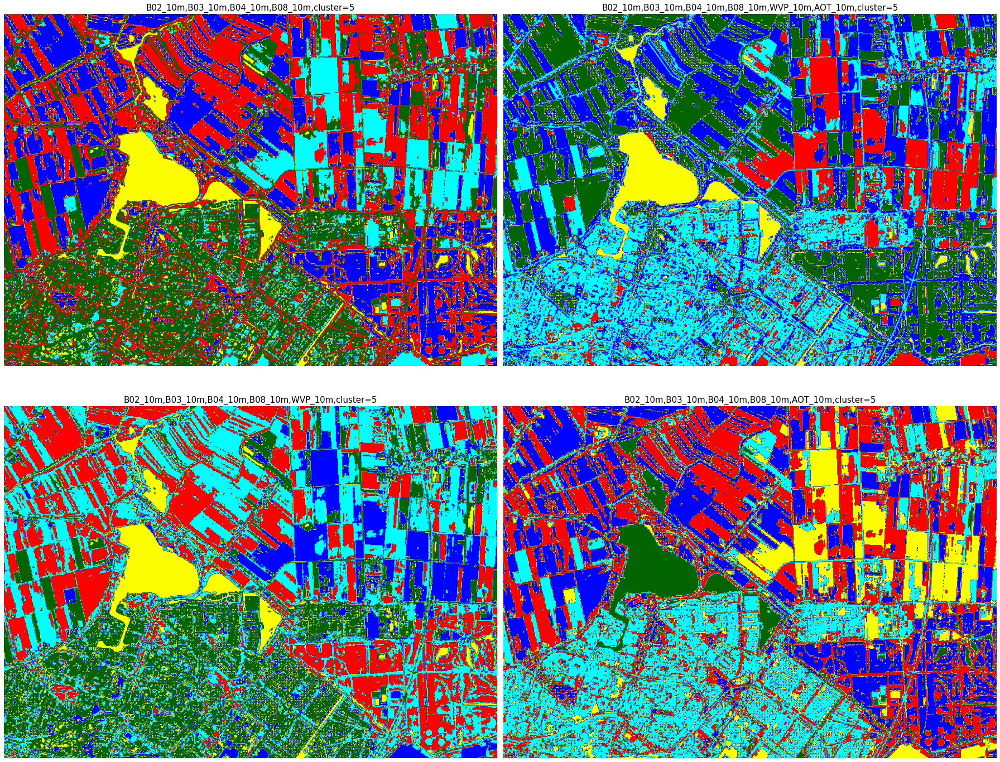

In [10]:
color = colors.LinearSegmentedColormap.from_list("", ["red","darkgreen","yellow","blue","cyan"]) 
fig = plt.figure(figsize=(25,20))
ax1 = fig.add_subplot(221)
bands_1 = [B02_10m,B03_10m,B04_10m,B08_10m]
ax1.imshow(kmeans_window(bands_1,5,win),cmap=color)
ax1.set_title('B02_10m,B03_10m,B04_10m,B08_10m,cluster=5',fontsize=15)
plt.axis('off')
ax2 = fig.add_subplot(222)
bands_2 = [AOT_10m,B02_10m,B03_10m,B04_10m,B08_10m,WVP_10m]
ax2.imshow(kmeans_window(bands_2,5,win),cmap=color)
ax2.set_title('B02_10m,B03_10m,B04_10m,B08_10m,WVP_10m,AOT_10m,cluster=5',fontsize=15)
plt.axis('off')
ax3 = fig.add_subplot(223)
bands_3 = [B02_10m,B03_10m,B04_10m,B08_10m,WVP_10m]
ax3.imshow(kmeans_window(bands_3,5,win),cmap=color)
ax3.set_title('B02_10m,B03_10m,B04_10m,B08_10m,WVP_10m,cluster=5',fontsize=15)
plt.axis('off')
ax4 = fig.add_subplot(224)
bands_4 = [B02_10m,B03_10m,B04_10m,B08_10m,AOT_10m]
ax4.imshow(kmeans_window(bands_4,5,win),cmap=color)
ax4.set_title('B02_10m,B03_10m,B04_10m,B08_10m,AOT_10m,cluster=5',fontsize=15)
plt.axis('off')
plt.tight_layout()
plt.show()

These four figures are roughly the same. We can tell AOT and WVP have little influence on clustering. Also, the combination of Red, Green, Blue and NIR bands is similar to the previous false color classification results which means Red band, Green band and Blue band have same effect in clustering. However, it might be the number of clusters which limites the classification result of the combination of all bands. 

## 2.4 Compare RGBNIR bands and all bands clustering with more clusters
In order to test the limited classification effect caused by the number of clusters, we compared the RGBNIR bands with all bands based on the increase in the number of clusters.

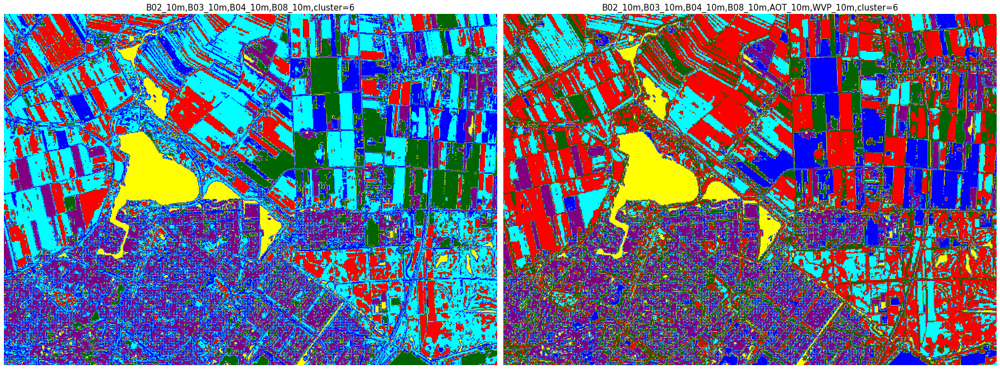

In [11]:
color = colors.LinearSegmentedColormap.from_list("", ["red","darkgreen","yellow","blue","cyan","purple"]) 
fig = plt.figure(figsize=(25,10))
bands_1 = [B02_10m,B03_10m,B04_10m,B08_10m]
bands_2 = [AOT_10m,B02_10m,B03_10m,B04_10m,B08_10m,WVP_10m]
ax1 = fig.add_subplot(121)
ax1.imshow(kmeans_window(bands_1,6,win),cmap=color)
ax1.set_title('B02_10m,B03_10m,B04_10m,B08_10m,cluster=6',fontsize=15)
plt.axis('off')
ax2 = fig.add_subplot(122)
ax2.imshow(kmeans_window(bands_2,6,win),cmap=color)
ax2.set_title('B02_10m,B03_10m,B04_10m,B08_10m,AOT_10m,WVP_10m,cluster=6',fontsize=15)
plt.axis('off')
plt.tight_layout()
plt.show()

The classification result of all bands did not exceed the RGBNIR bands due to the increase in the number of clusters. So the previous assumption is not true. Increasing the unaffected bands for kmeans analysis not only does not help the classification results, but also increases the computer processing time. Then for this area, the best choice for clustering is the combination of Red band, Green band, Blue band and NIR band.

## 2.5 Clusters selection for RGB NIR bands of 10m image
With the previous conclusions, we want to find out the most suitable number of clusters for RGBNIR bands clustering.

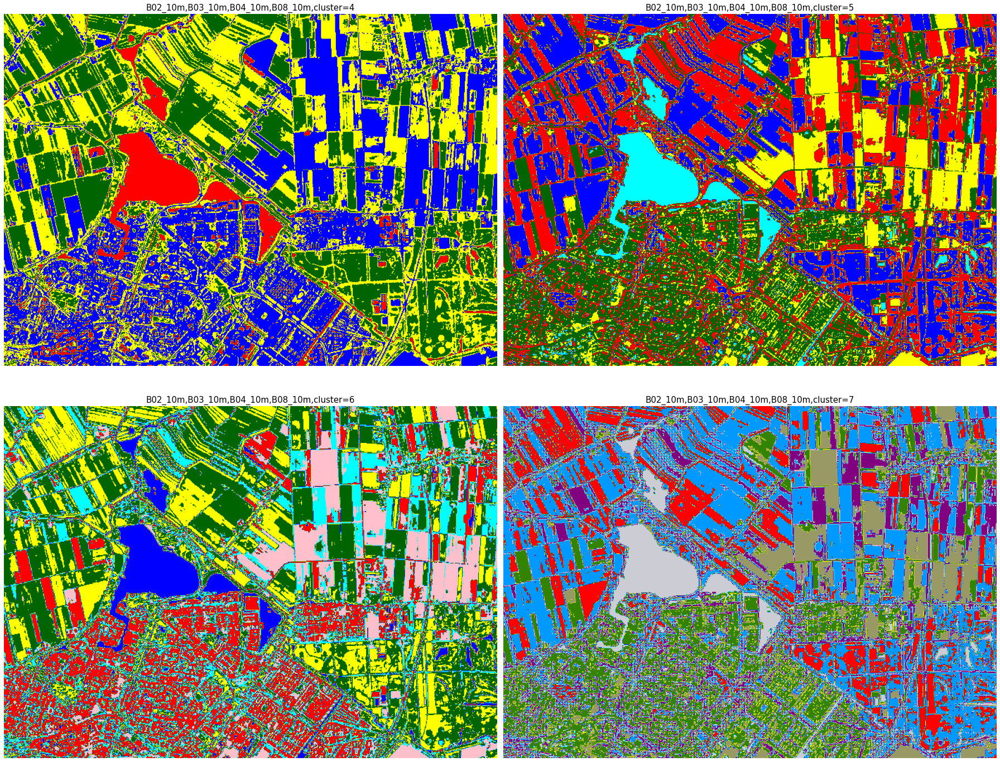

In [12]:
color_1 = colors.LinearSegmentedColormap.from_list("", ["red","darkgreen","yellow","blue"])
color_2 = colors.LinearSegmentedColormap.from_list("", ["red","darkgreen","yellow","blue","cyan"]) 
color_3 = colors.LinearSegmentedColormap.from_list("", ["red","darkgreen","yellow","blue","cyan","pink"]) 
color_4 = colors.LinearSegmentedColormap.from_list("", ["red","darkgreen","yellow","blue","cyan","pink","purple"]) 
fig = plt.figure(figsize=(25,20))
bands = [B02_10m,B03_10m,B04_10m,B08_10m]
ax1 = fig.add_subplot(221)
ax1.imshow(kmeans_window(bands,4,win),cmap=color_1)
ax1.set_title('B02_10m,B03_10m,B04_10m,B08_10m,cluster=4',fontsize=15)
plt.axis('off')
ax2 = fig.add_subplot(222)
ax2.imshow(kmeans_window(bands,5,win),cmap=color_2)
ax2.set_title('B02_10m,B03_10m,B04_10m,B08_10m,cluster=5',fontsize=15)
plt.axis('off')
ax3 = fig.add_subplot(223)
ax3.imshow(kmeans_window(bands,6,win),cmap=color_3)
ax3.set_title('B02_10m,B03_10m,B04_10m,B08_10m,cluster=6',fontsize=15)
plt.axis('off')
ax4 = fig.add_subplot(224)
ax4.imshow(kmeans_window(bands,6,win),cmap=color_4)
ax4.set_title('B02_10m,B03_10m,B04_10m,B08_10m,cluster=7',fontsize=15)
plt.axis('off')
plt.tight_layout()
plt.show()

Four clusters cannot classify buildings and farm land. Five, six and seven clusters all have good clustering results.

# 3 Conclusion
For the 60m image, the band combination of band2, band3, band4, band5, band6, band7 and band8A with 5 clusters will provide the best classification result according to our test. Band2, band3, band4 and band8A can already complete the classification with good effect, but the three red edge bands make the classification results further improved, which may be related to the large area of farmland in the study area.

For the 10m image, the best way to make landform clustering by Kmeans in this area of 10m is using Red band, Green band, Blue band and NIR band with five clusters. 
## pros
- The analysis logic and process can determine which bands are most beneficial for clustering.
- The code uses the K-means clustering algorithm, which can quickly get the clustering results based on different cluster number.

## cons
- By Kmeans clustering, we have to manually determine the landform type represented by each cluster. When there are many types of clusters, it is difficult to distinguish with the naked eye.
- By Kmeans clustering, we cannot set the color corresponding to a certain cluster. This makes the comparison between the pictures difficult to see.